## Assignment 5

This assignment is designed to help you understand, implement, and get hold of two important models in Multi-Modal Learning: CLIP and BLIP.

Before starting to code, read the instructions and comments carefully. Make sure you understand the requirements and the expected output.

There are two parts of this assignment.
- Content based image retrieval (CBIR) based on CLIP
- Visual Question Answering (VQA) based on BLIP

## Part 1: Content Based Image Retrieval (CBIR)

Ever found yourself looking for a specific image in a load of photos on your phone?
Imagine you have a system that can retrieve images based on their content. In this assignment, you will implement exactly that.

### Task
1. I have provided a list of images in form of unsplash links. Feel free to explore and add more images.
2. You will have to implement CBIR system that will retrive images based on the query you provide.
3. You have to use CLIP model to extract image and text embeddings. Since CLIP projects both image and text into the same embedding space, similar images and their corresponding text descriptions will be close to each other in the embedding space.
4. You have to use a pretrained CLIP model from HuggingFace. (Because it is not feasible to train CLIP from scratch)
5. You have to use [OpenAI's CLIP](https://huggingface.co/openai/clip-vit-base-patch32) model from HuggingFace. Refer to the page itself and anyother resources you find useful, on how to use it.
6. You will have to take an input query from user, and display the best image matching the query. (You can use cosine similarity to find similarity between the query and the images, then display the image with highest similarity score)

##### Load all the libraries

In [1]:
## Load libraries

from PIL import Image
import requests

from transformers import CLIPProcessor, CLIPModel

model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

IMAGE_URLS = [
    "https://images.unsplash.com/photo-1750126833705-ba98013f16f3",
    "https://images.unsplash.com/photo-1749627995669-4d4dda3a9c1d",
    "https://images.unsplash.com/photo-1744294724362-3f5c404c771a",
    "https://images.unsplash.com/photo-1750075750236-3f8924fc0e35"
]
# Feel free to edit the above list with your own image URLs

c:\Users\rohan\OneDrive\ドキュメント\Desktop\frame to fables\frame_env\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
c:\Users\rohan\OneDrive\ドキュメント\Desktop\frame to fables\frame_env\Lib\site-packages\huggingface_hub\file_download.py:143: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\rohan\.cache\huggingface\hub\models--openai--clip-vit-base-patch32. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mod

##### Load the CLIP model

##### Loop through images, convert then to tensors, and store them in a list

In [13]:
import torch
import requests
from PIL import Image
from io import BytesIO
import torchvision.transforms as transforms
images=[]
for url in IMAGE_URLS:
    response = requests.get(url)
    image = Image.open(BytesIO(response.content)).convert("RGB")

    
    inputs = processor(images=image, return_tensors="pt")
    
    
    images.append(inputs)

##### Get the embeddings for the images and store them in a list
Use the CLIP model linked above, the page also provides details on how to use it. If you have any issues with it, feel free to use anyother resources you find useful.

In [15]:
embed_imgs=[]
for image in images:

    with torch.no_grad():
        embeddings = model.get_image_features(**image)
        embed_imgs.append(embeddings)

In [16]:
embed_imgs[0]

tensor([[ 3.9741e-01, -1.0548e-01,  4.6489e-01,  1.9734e-01,  3.2573e-01,
         -3.8906e-02,  4.9292e-01,  1.6817e-01, -3.6367e-01, -1.8627e-01,
          3.2868e-01, -1.6957e-01,  3.5419e-01, -4.2688e-01,  7.3395e-01,
          2.1801e-01, -4.2500e-01, -9.8561e-02,  5.0656e-01,  1.7247e-01,
         -2.5074e-01,  3.4593e-01,  1.8501e-01, -9.5761e-01, -7.2642e-02,
          1.8815e-01,  2.1694e-01, -9.5771e-03, -5.3216e-01, -1.4662e-01,
         -4.0905e-01,  3.6026e-01, -2.5741e-02,  2.4428e-01,  3.1296e-01,
          2.5189e-01, -2.7785e-02,  9.1708e-02,  2.2748e-01,  7.9581e-01,
          2.7265e-01,  1.1566e-01, -1.3640e-01, -5.7350e-02,  1.2934e-02,
         -5.5915e-01,  1.5057e-01,  6.5666e-02,  1.7492e-01,  2.6301e-01,
          1.5253e-01,  7.1886e-02,  4.2071e-01, -6.4486e-02, -6.9490e-02,
         -1.5916e-01, -9.5058e-02,  5.4260e-03,  2.2292e-01,  5.8195e-01,
         -8.5660e-01, -5.5363e-03,  1.0480e-01, -2.7494e-01,  3.2487e-02,
         -2.0657e-01,  1.6165e-01,  3.

##### Get the query from user

In [1]:
query = input("Enter which image are you looking for: ")

##### Get the embeddings for the user query

In [25]:
query= " where is the boat"
text_inputs = processor(text=[query], return_tensors="pt", padding=True)
with torch.no_grad():
    text_embeddings = model.get_text_features(**text_inputs)
    text_embeddings = text_embeddings / text_embeddings.norm(p=2, dim=-1, keepdim=True)




##### Find the similarity between the query and all the images

In [28]:
similarities = []
for img in embed_imgs:
    similarity= torch.matmul(text_embeddings[0],img.T)
    similarities.append(similarity)
similarities

[tensor([2.6657]), tensor([2.0240]), tensor([2.1148]), tensor([2.0179])]

##### Display the image with highest similarity score

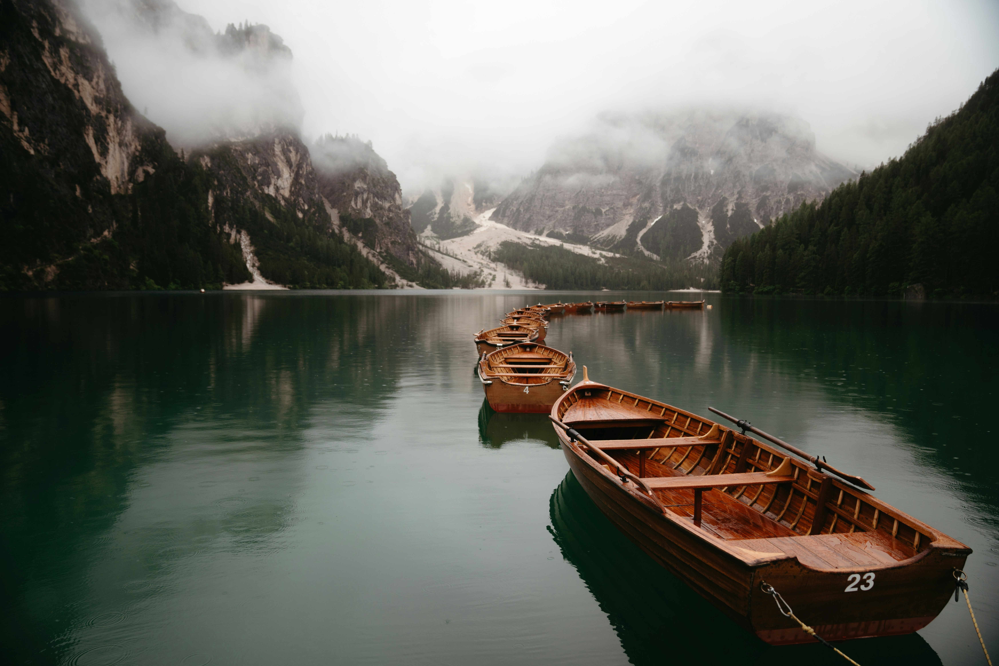

In [30]:
response = requests.get(IMAGE_URLS[0])
    
image_most_similar= Image.open(BytesIO(response.content)).convert("RGB")
image_most_similar

Congrats! You have implemented a simple Content Based Image Retrieval (CBIR) system using CLIP model.

Moving on to the next part of the assignment.

## Part 2: Visual Question Answering (VQA)

This part is based on Visual Question Answering (VQA), where you will be given an image and a question about that image, and you will need to provide an answer.

You are provided with a dataset of 10 images, and a json file containing questions and answers for those images.

### Format of JSON file
```json
[
    "what is the blue shape?",
    "rectangle",
    0
]
```
This means that the question is "what is the blue shape?", the answer is "rectangle", and the image index is 0.
Images are named from 0 to 9, so the image for index 0 is `0.png`.

### Task
1. Load the JSON file and parse the questions and answers.
2. Just for understanding, print a few questions and their corresponding answers, also display the corresponding images. (You may do it for 1 or 2 questions)
3. Implement a function that takes an image and a question, and returns the answer.
4. Run the function on all questions and store the answers in a file. (You can store it in a new JSON or CSV file) (May use pandas for this)
5. Now since you have the answers, you can also evaluate your model. For this, you can compare your answers with the ground truth answers provided in the JSON file. (refer to note below)

Note: But it is not that easy to compare directly, as the answers may not match exactly due to variations in phrasing ("2" and "two", "blue" and "The color is blue". Phrases like this don't match, but are correct). So you should check your answers manually and see if they are correct or not. Do it for first 30 answers, and calculate the accuracy.
There are certain ways to automate this, but they will make this assignment too complicated, so we will not do that here.

### Additional Points
- Refer to BLIP model that was taught in last class. It can be used to answer questions based on images.
- You will have to use pre-trained BLIP model for this task. (Because training it from scratch is not feasible in this assignment)
- You have to use [Salesforce BLIP model](https://huggingface.co/Salesforce/blip-vqa-base) for this task. Refer to the Usage section of page for details on how to use it. If you feel stuck, you can refer to blogs available online, or use AI tools to get yourself familiar with the model.

1. Load libraries, and the JSON file.

In [32]:
import requests
from PIL import Image
import json
from transformers import BlipProcessor, BlipForQuestionAnswering

processor = BlipProcessor.from_pretrained("Salesforce/blip-vqa-base")
model = BlipForQuestionAnswering.from_pretrained("Salesforce/blip-vqa-base").to("cuda")


c:\Users\rohan\OneDrive\ドキュメント\Desktop\frame to fables\frame_env\Lib\site-packages\huggingface_hub\file_download.py:143: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\rohan\.cache\huggingface\hub\models--Salesforce--blip-vqa-base. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


In [34]:
with open('filtered_questions.json', 'r') as file:
    data_list = json.load(file)

2. Display a few questions and answers along with images.

question :what is the blue shape?
answer: rectangle
image: 


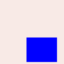

In [36]:
print(f"question :{data_list[0][0]}")
print(f"answer: {data_list[0][1]}")
from PIL import Image
image = Image.open(f"images_updated/{data_list[0][2]}.png")

print(f"image: ")
image

3. Implement the function to answer questions based on images.

In [42]:
def vqa(question, image):
    inputs = processor(image, question, return_tensors="pt").to("cuda")

    out = model.generate(**inputs)
    return processor.decode(out[0], skip_special_tokens=True)

type(vqa(data_list[0][0],image))

str

4. Run the function on all questions and store the answers in a file.

In [43]:
answers =[]
for data in data_list:
    image =Image.open(f"images_updated/{data[2]}.png")
    answers.append(vqa(data[0],image))

5. Evaluate the model by comparing answers with ground truth.
Do the comparison manually for the first 30 answers and print the accuracy.

In [44]:
# for the first thirty accuracy will be
for i in range(30):
    print(answers[i] ,  data_list[i][1])

rectangle rectangle
black blue
yes yes
no no
yes no
yes yes
no no
yes yes
yes no
yes no
yes yes
yes no
blue blue
blue blue
yes yes
no no
no no
yes yes
triangle triangle
triangle triangle
red red
red red
no no
no no
no no
no no
yes yes
square rectangle
square rectangle
red brown


In [45]:
accuracy = 24*100/30
print(accuracy)

80.0


Bonus: This images were too simple. But guess what? Salesforce has pretrained it's model on wide variety of images, so you can use it on any image of your choice.

Try to load any real world image of any natural scene, or anything you like, and ask questions about it. You will be surprised by the results.

The End 🫡.

If you have any questions, feel free to use following in the given order:
- Google it!!
- ChatGPT
- Ask on the group